In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa

# import kaggle as kd
import matplotlib.pyplot as plt
import numpy as np
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

# print(dir(kd))
strategy = tf.distribute.get_strategy()



gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

# strategy = tf.distribute.Strategy()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!unzip "/content/drive/My Drive/AML-Project/portraits.zip"
!unzip "/content/drive/My Drive/AML-Project/Fam2a.zip"

In [ ]:
!unzip "/content/drive/My Drive/AML-Project/archive (1).zip"

In [ ]:
nno# Cropping Art#

import random, os, time
from PIL import Image

INPATH = r"portraits/"
OUTPATH = r"cropped/portraits/"

dx = dy = 256
tilesPerImage = 3
# Random Crop
files = os.listdir(INPATH)
numOfImages = len(files)
print(files)
t = time.time()
for file in files:
  if not '.jpg' in file:
    print(os.path.join(INPATH, file))
    subdir =  file
    subdirPath = os.path.join(INPATH, file) + "/"
    if file != ".DS_Store":
      subdirFiles = os.listdir(subdirPath )
      for imgFile in subdirFiles:
        with Image.open(os.path.join(subdirPath, imgFile)) as im:
          for i in range(1, tilesPerImage+1):
            print(im.size)
            # newname = file.replace('.', '_{:03d}.'.format(i))
            w, h = im.size
            if w ==256:
              x = 0
            else:
              x = random.randint(0, w-dx-1)
            if h == 256:
              y = 0
            else:
              y = random.randint(0, h-dy-1)
            print("Cropping {}: {},{} -> {},{}".format(file, x,y, x+dx, y+dy))
            if not os.path.exists(OUTPATH + file):
              os.makedirs(OUTPATH + file)
            im.crop((x,y, x+dx, y+dy)).save(OUTPATH + file +"/" + str(i) +"crop" + imgFile)

t = time.time()-t
print("Done {} images in {:.2f}s".format(numOfImages, t))
print("({:.1f} images per second)".format(numOfImages/t))
print("({:.1f} tiles per second)".format(tilesPerImage*numOfImages/t))

In [ ]:
# Cropping Photos#

import random, os, time
from PIL import Image

INPATH = r"Fam2AHolder/Fam2a/"
OUTPATH = r"cropped/cropFam/Fam2a/"

dx = dy = 256
tilesPerImage = 3
# Random Crop
files = os.listdir(INPATH)
numOfImages = len(files)
print(files)
t = time.time()
for file in files:
  if ".ipynb_checkpoints" not in file and "PersonData.txt" not in file:
    with Image.open(os.path.join(INPATH, file)) as im:
      for i in range(1, tilesPerImage+1):
              w, h = im.size
              if w ==256:
                x = 0
              else:
                x = random.randint(0, w-dx-1)
              if h == 256:
                y = 0
              else:
                y = random.randint(0, h-dy-1)
              print("Cropping {}: {},{} -> {},{}".format(file, x,y, x+dx, y+dy))
              im.crop((x,y, x+dx, y+dy)).save(OUTPATH+str(i) + "crop" + file)

t = time.time()-t
print("Done {} images in {:.2f}s".format(numOfImages, t))
print("({:.1f} images per second)".format(numOfImages/t))
print("({:.1f} tiles per second)".format(tilesPerImage*numOfImages/t))

In [ ]:
# Importing Images

allStylesDataset = tf.keras.preprocessing.image_dataset_from_directory(
    "/content/cropped/portraits", labels='inferred', label_mode='int', class_names=None,
    color_mode='rgb', batch_size=32, image_size=(256, 256), shuffle=True, seed=None,
    validation_split=None, subset=None, interpolation='bilinear', follow_links=False
)

famDataset = tf.keras.preprocessing.image_dataset_from_directory(
    "/content/Fam2AHolder",  label_mode=None, class_names=None,
    color_mode='rgb', batch_size=32, image_size=(256, 256), shuffle=True, seed=None,
    validation_split=None, subset=None, interpolation='bilinear', follow_links=False
)

# famDataset = tf.keras.preprocessing.image_dataset_from_directory(
#     "/content/Fam2AHolder",  label_mode=None, class_names=None,
#     color_mode='rgb', batch_size=32, image_size=(256, 256), shuffle=True, seed=None,
#     validation_split=None, subset=None, interpolation='bilinear', follow_links=False
# )

# class_names = allStylesDataset.class_names
class_names = allStylesDataset.class_names
print(class_names )



Found 38631 files belonging to 93 classes.
Found 754 files belonging to 1 classes.
['Abstract Art', 'Abstract Expressionism', 'Academicism', 'American Realism', 'Analytical Cubism', 'Analytical\xa0Realism', 'Art Brut', 'Art Deco', 'Art Informel', 'Art Nouveau (Modern)', 'Baroque', 'Biedermeier', 'Classicism', 'Cloisonnism', 'Conceptual Art', 'Concretism', 'Constructivism', 'Contemporary Realism', 'Costumbrismo', 'Cubism', 'Cubo-Expressionism', 'Cubo-Futurism', 'Dada', 'Divisionism', 'Early Renaissance', 'Existential Art', 'Expressionism', 'Fantastic Realism', 'Fauvism', 'Feminist Art', 'Figurative Expressionism', 'Futurism', 'Gongbi', 'High Renaissance', 'Hyper-Realism', 'Impressionism', 'Ink and wash painting', 'International Gothic', 'Intimism', 'Japonism', 'Kitsch', 'Lettrism', 'Luminism', 'Lyrical Abstraction', 'Magic Realism', 'Mannerism (Late Renaissance)', 'Mechanistic Cubism', 'Metaphysical art', 'Modernismo', 'Muralism', 'Naïve Art (Primitivism)', 'Nanga (Bunjinga)', 'Neo-Dad

In [ ]:
print(class_names)
for index, i in enumerate(class_names):
  if i == "Pop Art":
    print(index)

['Abstract Art', 'Abstract Expressionism', 'Academicism', 'American Realism', 'Analytical Cubism', 'Analytical\xa0Realism', 'Art Brut', 'Art Deco', 'Art Informel', 'Art Nouveau (Modern)', 'Baroque', 'Biedermeier', 'Classicism', 'Cloisonnism', 'Conceptual Art', 'Concretism', 'Constructivism', 'Contemporary Realism', 'Costumbrismo', 'Cubism', 'Cubo-Expressionism', 'Cubo-Futurism', 'Dada', 'Divisionism', 'Early Renaissance', 'Existential Art', 'Expressionism', 'Fantastic Realism', 'Fauvism', 'Feminist Art', 'Figurative Expressionism', 'Futurism', 'Gongbi', 'High Renaissance', 'Hyper-Realism', 'Impressionism', 'Ink and wash painting', 'International Gothic', 'Intimism', 'Japonism', 'Kitsch', 'Lettrism', 'Luminism', 'Lyrical Abstraction', 'Magic Realism', 'Mannerism (Late Renaissance)', 'Mechanistic Cubism', 'Metaphysical art', 'Modernismo', 'Muralism', 'Naïve Art (Primitivism)', 'Nanga (Bunjinga)', 'Neo-Dada', 'Neo-Expressionism', 'Neo-Figurative Art', 'Neo-Rococo', 'Neo-Romanticism', 'Ne

In [ ]:
# Build out impressionism dataset

import matplotlib.pyplot as plt

# plt.figure(figsize=(10, 10))
impressionism = []
for images, labels in allStylesDataset.take(-1):
  # print(images)
  # print(len(images))
  for i in range(len(images)):
    if labels[i] == 68:
      impressionism.append(images[i].numpy())
      # ax = plt.subplot(3, 3, i + 1)
      # plt.imshow(images[i].numpy().astype("uint8"))
      # plt.title(class_names[labels[i]])
      # plt.axis("off")
print(len(impressionism))
impressionism_DS = tf.data.Dataset.from_generator(lambda: impressionism, tf.float32)

351


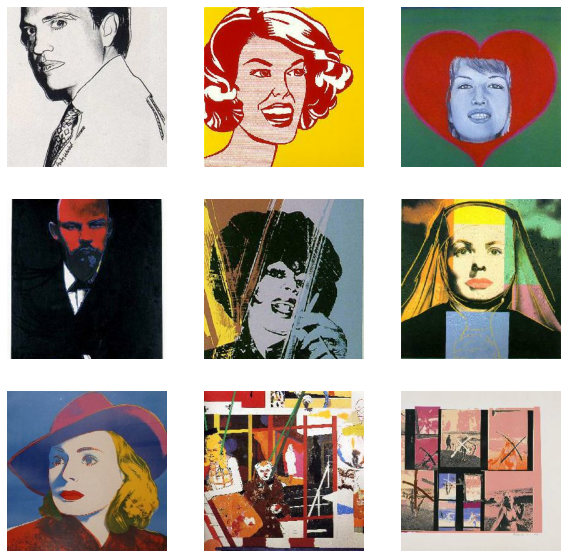

In [ ]:
# Show Art
plt.figure(figsize=(10, 10))
i = 0
for images in impressionism_DS.take(9):
      ax = plt.subplot(3, 3, i + 1)
      plt.imshow(images.numpy().astype("uint8"))
      # plt.title(class_names[labels[i]])
      plt.axis("off")
      i+=1


<TakeDataset shapes: (None, 256, 256, 3), types: tf.float32>


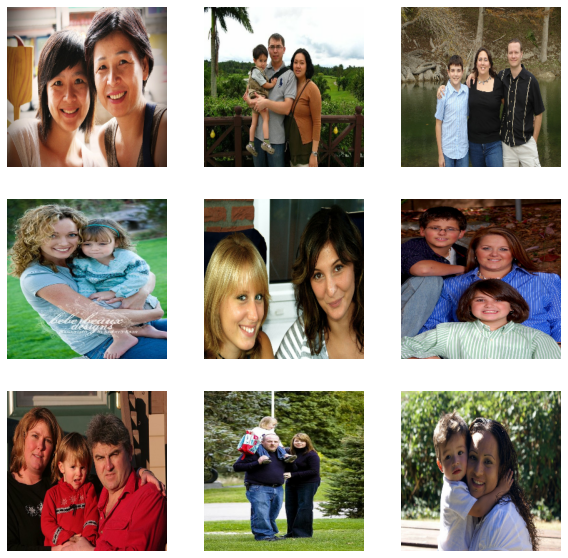

In [ ]:
# Show Real Photos

plt.figure(figsize=(10, 10))
i = 0
for images in famDataset.take(9):
      ax = plt.subplot(3, 3, i + 1)
      plt.imshow(images[i].numpy().astype("uint8"))
      # plt.title(class_names[labels[i]])
      plt.axis("off")
      i+=1
print(famDataset.take(1))

In [ ]:
# Normalization

normalization_layer = layers.experimental.preprocessing.Rescaling(1./127.5, offset=-1)

normalized_impressionism = impressionism_DS.map(lambda x: (normalization_layer(x))).batch(1)

normalized_famData = famDataset.map(lambda x: (normalization_layer(x))).unbatch().batch(1)


# impression = next(iter(normalized_impressionism))

# fam = next(iter(normalized_famData))

# normalized_impressionism = normalized_impressionism.shuffle(100, reshuffle_each_iteration=True)
# normalized_famData = normalized_famData.shuffle(100, reshuffle_each_iteration=True)


In [ ]:
print(normalized_impressionism.shape())

AttributeError: ignored

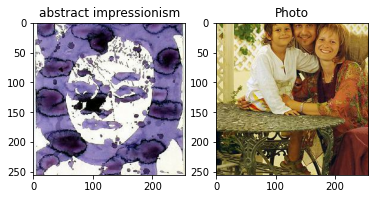

In [ ]:
# iterPhotos= iter(normalized_famData)
print(iter)

<built-in function iter>


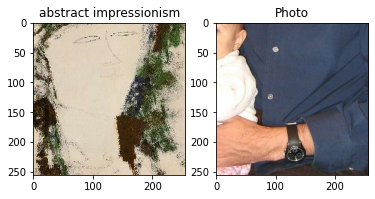

In [ ]:
example_impressionism = next(iter(normalized_impressionism))
# iterPhotos= iter(normalized_famData)
example_photo = next(iterPhotos)
# print(example_impressionism)
plt.subplot(121)
plt.title('abstract impressionism')
plt.imshow(example_impressionism[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Photo')
plt.imshow(example_photo[0] * 0.5 + 0.5)

In [ ]:
# DownSample

OUTPUT_CHANNELS = 3

def downsample(filters, size, apply_instancenorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_instancenorm:
        result.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    result.add(layers.LeakyReLU())

    return result

In [ ]:
# UpSample

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    result.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    if apply_dropout:
        result.add(layers.Dropout(0.5))

    result.add(layers.ReLU())

    return result

In [ ]:
# Generator

def Generator():
    inputs = layers.Input(shape=[256,256,3])

    # bs = batch size
    down_stack = [
        downsample(64, 4, apply_instancenorm=False), # (bs, 128, 128, 64)
        downsample(128, 4), # (bs, 64, 64, 128)
        downsample(256, 4), # (bs, 32, 32, 256)
        downsample(512, 4), # (bs, 16, 16, 512)
        downsample(512, 4), # (bs, 8, 8, 512)
        downsample(512, 4), # (bs, 4, 4, 512)
        downsample(512, 4), # (bs, 2, 2, 512)
        downsample(512, 4), # (bs, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
        upsample(512, 4), # (bs, 16, 16, 1024)
        upsample(256, 4), # (bs, 32, 32, 512)
        upsample(128, 4), # (bs, 64, 64, 256)
        upsample(64, 4), # (bs, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                  strides=2,
                                  padding='same',
                                  kernel_initializer=initializer,
                                  activation='tanh') # (bs, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    x = last(x)
    return keras.Model(inputs=inputs, outputs=x)


In [ ]:
# Discriminator

def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    inp = layers.Input(shape=[256, 256, 3], name='input_image')

    x = inp

    down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1,
                         kernel_initializer=initializer,
                         use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)

    leaky_relu = layers.LeakyReLU()(norm1)

    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = layers.Conv2D(1, 4, strides=1,
                         kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=inp, outputs=last)

In [ ]:
with strategy.scope():
    imp_generator = Generator() # transforms photos to Monet-esque paintings
    photo_generator = Generator() # transforms Monet paintings to be more like photos

    imp_discriminator = Discriminator() # differentiates real Monet paintings and generated Monet paintings
    photo_discriminator = Discriminator() # differentiates real photos and generated photos

In [ ]:
class CycleGan(keras.Model):
    def __init__(
        self,
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        lambda_cycle=10,
    ):
        super(CycleGan, self).__init__()
        self.m_gen = monet_generator
        self.p_gen = photo_generator
        self.m_disc = monet_discriminator
        self.p_disc = photo_discriminator
        self.lambda_cycle = lambda_cycle
        
    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn
    ):
        super(CycleGan, self).compile()
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        
    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        
        with tf.GradientTape(persistent=True) as tape:
            # photo to monet back to photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)

            # monet to photo back to monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)

            # generating itself
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)

            # discriminator used to check, inputing real images
            disc_real_monet = self.m_disc(real_monet, training=True)
            disc_real_photo = self.p_disc(real_photo, training=True)

            # discriminator used to check, inputing fake images
            disc_fake_monet = self.m_disc(fake_monet, training=True)
            disc_fake_photo = self.p_disc(fake_photo, training=True)

            # evaluates generator loss
            monet_gen_loss = self.gen_loss_fn(disc_fake_monet)
            photo_gen_loss = self.gen_loss_fn(disc_fake_photo)

            # evaluates total cycle consistency loss
            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle) + self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle)

            # evaluates total generator loss
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss + self.identity_loss_fn(real_monet, same_monet, self.lambda_cycle)
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_cycle)

            # evaluates discriminator loss
            monet_disc_loss = self.disc_loss_fn(disc_real_monet, disc_fake_monet)
            photo_disc_loss = self.disc_loss_fn(disc_real_photo, disc_fake_photo)

        # Calculate the gradients for generator and discriminator
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                  self.m_gen.trainable_variables)
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.p_gen.trainable_variables)

        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.m_disc.trainable_variables)
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.p_disc.trainable_variables)

        # Apply the gradients to the optimizer
        self.m_gen_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.p_disc.trainable_variables))
        
        return {
            "monet_gen_loss": total_monet_gen_loss,
            "photo_gen_loss": total_photo_gen_loss,
            "monet_disc_loss": monet_disc_loss,
            "photo_disc_loss": photo_disc_loss
        }

In [ ]:
with strategy.scope():
    def discriminator_loss(real, generated):
        real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(real), real)

        generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.zeros_like(generated), generated)

        total_disc_loss = real_loss + generated_loss

        return total_disc_loss * 0.5


In [ ]:
with strategy.scope():
    def generator_loss(generated):
        return tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(generated), generated)

In [ ]:
with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):
        loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))

        return LAMBDA * loss1

In [ ]:
with strategy.scope():
    def identity_loss(real_image, same_image, LAMBDA):
        loss = tf.reduce_mean(tf.abs(real_image - same_image))
        return LAMBDA * 0.5 * loss

In [ ]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    monet_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        imp_generator, photo_generator, imp_discriminator, photo_discriminator
    )

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss
    )

In [ ]:
tf.keras.backend.clear_session()
cycle_gan_model.fit(tf.data.Dataset.zip((normalized_impressionism, normalized_famData)),epochs=25)



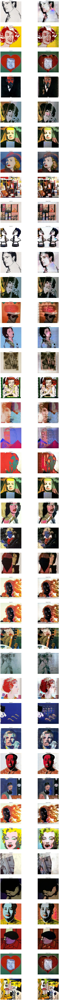

In [ ]:
photosToGenerate = 40

_, ax = plt.subplots(photosToGenerate, 2, figsize=(20, 300))
for i, img in enumerate(normalized_impressionism.take(photosToGenerate)):
    prediction = photo_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input Art")
    ax[i, 1].set_title("Output Photo")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
plt.show()



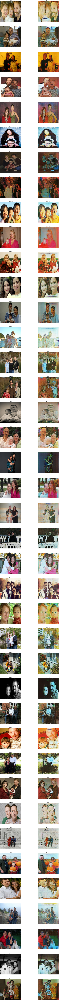

In [ ]:
artToGenerate = 40

_, ax = plt.subplots(artToGenerate, 2, figsize=(20, 300))
for i, img in enumerate(normalized_famData.take(artToGenerate)):
    prediction = imp_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input Photo")
    ax[i, 1].set_title("Output Art")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
plt.show()